In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow.keras.backend as K

import scipy.stats as ss
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from easydict import EasyDict
from tqdm.notebook import tqdm,trange
from sklearn.metrics import roc_auc_score

In [2]:
from sklearn.linear_model import LogisticRegression

In [4]:
# export
def batch(x, y, n_p, n_u):
    x_p, ix_p = batchPos(x, y, n_p)
    x_u, ix_u = batchUL(x, y, n_u)
    xx = np.concatenate((x_p, x_u), axis=0)
    ix = np.concatenate((ix_p, ix_u), axis=0)
    return xx, y[ix, :], x_p, x_u, ix


def batchPos(x, y, n_p):
    return batchY(x, y, 1, n_p)


def batchUL(x, y, n_u):
    return batchY(x, y, 0, n_u)

def batchY(x, y, value, n, *args):
    ix = (y == value).flatten( )
    ix_all = np.arange(np.size(y))
    ix = ix_all[ix]
    if args:
        p = args[0].flatten()
        p = p[ix]
        ix_p = bernoulli.rvs(p)
        ix_p = np.cast['bool'](ix_p)
        ix = ix[ix_p]
    ix = np.random.choice(ix, n, replace=True)
    xx = x[ix, :]
    return xx, ix

In [5]:
class Mixture:

    def __init__(self, components, mixing_proportion):
        self.comps = components
        self.mixProp = mixing_proportion

    def pdf(self, x):
        return np.add(*[pi * comp.pdf(x) for (comp,pi) in zip(self.comps, self.mixProp)])

    def cdf(self, x):
        return np.add((p * comp.cdf(x) for (comp, p) in zip(self.comps, self.mixProp)), axis=-1)

    def rvs(self, size):
        sizes = np.cast['int32'](np.floor(size * self.mixProp))
        #pdb.set_trace()
        delta = np.cast['int32'](size - np.sum(sizes))
        ix = np.random.choice(np.size(self.mixProp), size=delta, p=self.mixProp)
        for ii in ix:
            sizes[ii] = sizes[ii] + 1
        dim = np.size(self.comps[0].rvs(size=1))
        x = np.empty([0, dim])
        for (s, comp) in zip(sizes, self.comps):
            new = comp.rvs(size=[s, 1])
            if len(new.shape) == 1:
                new = np.expand_dims(new,1)
            x = np.concatenate((x,new), axis=0)
        #pdb.set_trace()
        return x

    def rvsCompInfo(self, size):
        sizes = np.cast['int32'](np.floor(size * self.mixProp))
        #pdb.set_trace()
        delta = np.cast['int32'](size - np.sum(sizes))
        ix = np.random.choice(np.size(self.mixProp), size=delta, p=self.mixProp)
        for ii in ix:
            sizes[ii] = sizes[ii] + 1
        dim = np.size(self.comps[0].rvs(size=1))
        x = np.empty([0, dim])
        y = np.empty([0, 1])
        k = 0
        for (s, comp) in zip(sizes, self.comps):
            new = comp.rvs(size=[s, 1])
            print(x.shape, new.shape)
            x = np.concatenate((x, new), axis=0)
            y = np.concatenate((y, np.zeros([s, 1]) + k), axis=0)
            k = k + 1
        #pdb.set_trace()
        return x, y

    def component_pdfs(self, x):
        return (comp.pdf(x) for comp in self.comps)


In [84]:
NLP=100
NUP = 5000
NN = 5000
DIM = 64
ZDIM = max(1,int(DIM/2))
OFFSET = .125

classPrior = NUP / (NUP + NN)
# f0 = ss.multivariate_normal(np.zeros(DIM) + OFFSET,np.eye(DIM))
# f1 = ss.multivariate_normal(np.zeros(DIM) - OFFSET,np.eye(DIM))
f0 = Mixture([
    ss.multivariate_normal(np.zeros(DIM) + OFFSET,np.eye(DIM)),
    ss.multivariate_normal(np.zeros(DIM) +  OFFSET, np.eye(DIM))
],[.5,.5])
f1 = Mixture([
    ss.multivariate_normal(np.zeros(DIM) - OFFSET,np.eye(DIM)),
    ss.multivariate_normal(np.zeros(DIM) - OFFSET, np.eye(DIM))
],[.5,.5])
posterior = lambda x: classPrior * f1.pdf(x).ravel() / (classPrior * f1.pdf(x).ravel() + (1 - classPrior) * f0.pdf(x).ravel())

xUnlabeled = np.concatenate((f0.rvs(NN),f1.rvs(NUP)))
yPN = np.concatenate((np.zeros(NN),
                    np.ones(NUP))).astype(bool)
xPos = f1.rvs(NLP)


xPosTrain, xPosVal = train_test_split(xPos,test_size=.1)
xUnlabeledTrain,xUnlabeledVal,yPNTrain,yPNVal = train_test_split(xUnlabeled,yPN,test_size=.1)

In [85]:
roc_auc_score(yPNVal,posterior(xUnlabeledVal))

0.9143880012361584

In [86]:
if DIM == 1:
    rng = np.arange(-5,5,.1)
    plt.plot(rng, f0.pdf(rng))
    plt.plot(rng, f1.pdf(rng))
    plt.plot(rng,posterior(rng))

In [87]:
def cross_entropy_with_logits(logits, targets):
    log_prob = tf.nn.log_softmax(logits)
    return -tf.reduce_mean(tf.reduce_sum(targets * log_prob, 1))

In [207]:
baseline_inputs = keras.Input(shape=DIM,name="baseline_inputs")
baselinelayers = keras.models.Sequential([
    layers.Dense(32),
    layers.BatchNormalization(),
    layers.Activation("relu"),
    layers.Dense(32),
    layers.BatchNormalization(),
    layers.Activation("relu"),
    layers.Dense(32),
    layers.BatchNormalization(),
    layers.Activation("relu"),
])
baseline_output = layers.Dense(1,activation="sigmoid",name="baseline_output")(baselinelayers(baseline_inputs))
baselineModel = keras.Model([baseline_inputs],
                            [baseline_output],name="baselineModel")
baselineModel.summary()


Model: "baselineModel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 baseline_inputs (InputLayer  [(None, 64)]             0         
 )                                                               
                                                                 
 sequential_55 (Sequential)  (None, 32)                4576      
                                                                 
 baseline_output (Dense)     (None, 1)                 33        
                                                                 
Total params: 4,609
Trainable params: 4,417
Non-trainable params: 192
_________________________________________________________________


In [208]:
def Loss(alpha, Beta=.25):
    
    def loss_function(pos_out, unlabeled_out):
        # Cross Entropy Loss
#         RuMinus = tf.reduce_mean(-tf.math.log(1-unlabeled_out))
#         RpMinus = tf.reduce_mean(-tf.math.log(1-pos_out))
#         RpPlus = tf.reduce_mean(-tf.math.log(pos_out))
        # Squared Error Loss
        RuMinus = tf.reduce_mean(tf.math.square(unlabeled_out))
        RpMinus = tf.reduce_mean(tf.math.square(pos_out))
        RpPlus = tf.reduce_mean(tf.math.square(1-pos_out))
        # Sigmoid Loss
#         RuMinus = tf.reduce_mean(tf.math.sigmoid(unlabeled_out))
#         RpMinus = tf.reduce_mean(tf.math.sigmoid(pos_out))
#         RpPlus = tf.reduce_mean(tf.math.sigmoid(-1 * pos_out))
        # Logistic Loss
#         RuMinus = tf.reduce_mean(tf.math.log(1 + tf.math.exp(unlabeled_out)))
#         RpMinus = tf.reduce_mean(tf.math.log(1 + tf.math.exp(pos_out)))
#         RpPlus = tf.reduce_mean(tf.math.log(1 + tf.math.exp(-1 * pos_out)))
        # Squared Loss
#         RuMinus = tf.reduce_mean(tf.math.pow(-unlabeled_out-1,2)/4)
#         RpMinus = tf.reduce_mean(tf.math.pow(-pos_out-1,2)/4)
#         RpPlus = tf.reduce_mean(tf.math.pow(pos_out-1,2)/4)
        # Hinge Loss
#         RuMinus = tf.reduce_mean(tf.maximum(1 + unlabeled_out, 0))
#         RpMinus = tf.reduce_mean(tf.maximum(1 + pos_out, 0))
#         RpPlus = tf.reduce_mean(tf.maximum(1 - pos_out, 0))
        
        return RuMinus, RpMinus, RpPlus,
#         return alpha * RpPlus, RuMinus - alpha * RpMinus,(RuMinus - alpha * RpMinus) < 0 
    return loss_function

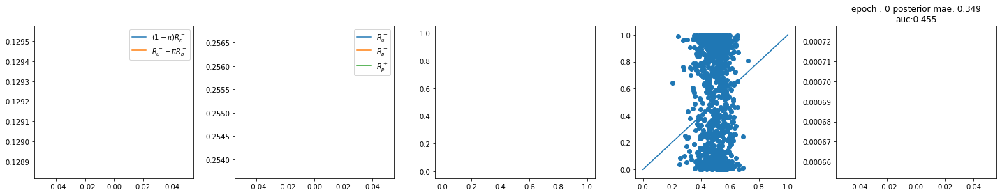

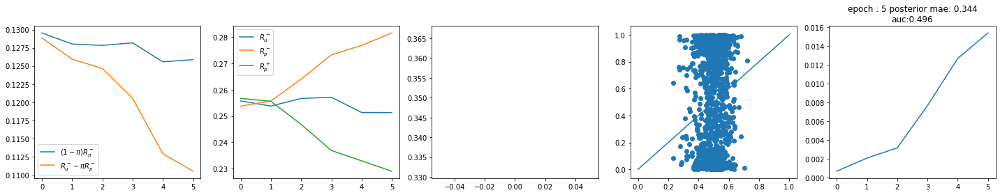

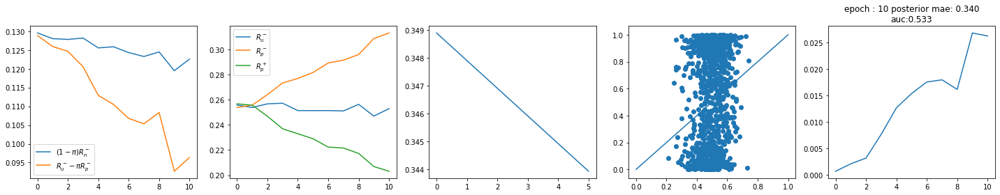

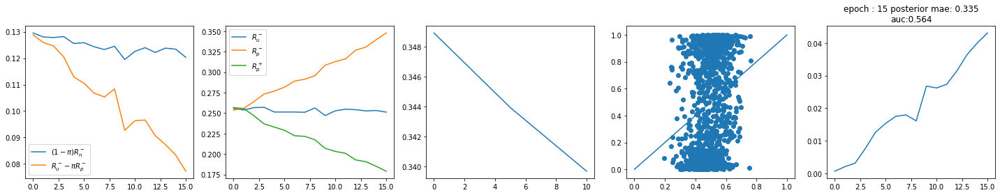

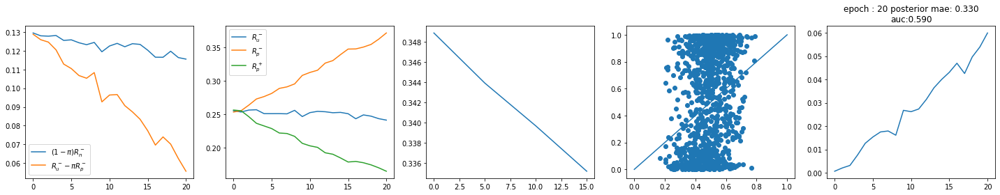

...

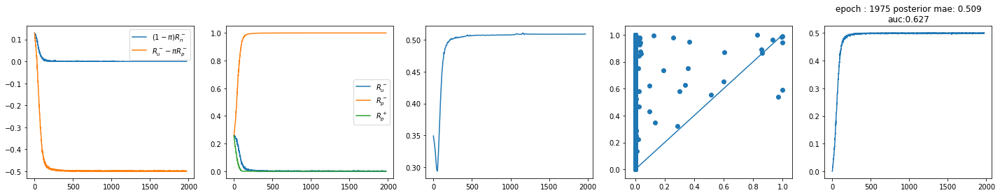

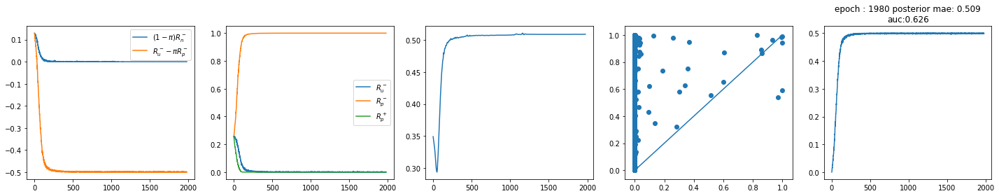

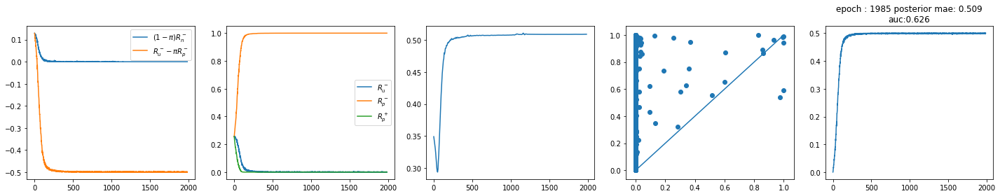

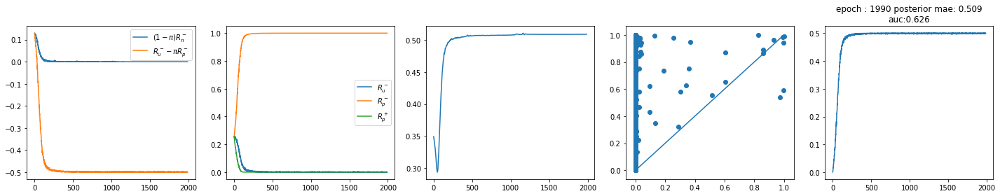

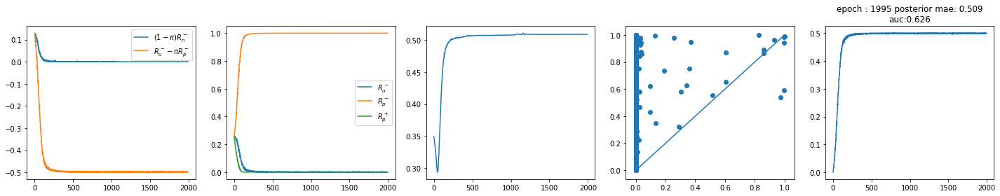

In [209]:
opt = tf.keras.optimizers.Adam(learning_rate=1e-3)
baselinePosteriorMAEs = []
baselineAUCs = []
lossFn= Loss(classPrior,Beta=0)
posLosses = []
negLosses = []
USEMIXUP = False
USEABS = False
mixupLosses = []
batchSize= 1024
trainScores = np.zeros_like(yPNTrain)
NEPOCHS = 2000
PLOTEVERY = 5
lossPNs = []
RuMinuses = []
RpMinuses = []
RpPlusses = []
minLoss, patience = np.inf, 0
LAMBDA = 0
for epoch in trange(NEPOCHS):
    if epoch > 0 and not epoch % NEPOCHS:
        opt.lr.assign(opt.lr/LRDECAYFACTOR)
    xx,yy,x_p,x_u, ix = batch(np.concatenate((xPosTrain,xUnlabeledTrain)),
                           np.concatenate((np.ones(xPosTrain.shape[0]),
                                           np.zeros(xUnlabeledTrain.shape[0])))[:,None],batchSize,batchSize)
    unlabeledIX = (ix-xPosTrain.shape[0])[-batchSize:]
    yyPN = yPNTrain[unlabeledIX]
    with tf.GradientTape() as tape:
        out_pos = baselineModel(x_p)
        out_unlabeled = baselineModel(x_u)
        neg_out = out_unlabeled[~yyPN]
        RuMinus, RpMinus, RpPlus = lossFn(out_pos, out_unlabeled)
#         total_loss = classPrior * RpPlus + tf.maximum(0,RuMinus - classPrior * RpMinus)
        total_loss = classPrior * RpPlus + RuMinus - classPrior * RpMinus + LAMBDA * tf.square(RuMinus - classPrior)
#         total_loss = classPrior * RpPlus + tf.abs(RuMinus - classPrior * RpMinus)
    lossPNs.append((1-classPrior) * tf.reduce_mean(tf.math.square(neg_out)).numpy())
    RuMinuses.append(RuMinus.numpy())
    RpMinuses.append(RpMinus.numpy())
    RpPlusses.append(RpPlus.numpy())
    grads = tape.gradient(total_loss,baselineModel.trainable_variables)
    opt.apply_gradients(zip(grads,baselineModel.trainable_variables))
    if total_loss < minLoss:
        minLoss = total_loss.numpy()
        patience = 0
    else:
        patience += 1
    if patience == NEPOCHS:
        break
    if not epoch % PLOTEVERY:
        fig,ax=  plt.subplots(1,5,figsize=(20,4))
        ax[0].plot(lossPNs,label="$(1-\pi)R_n^-$")
        ax[0].plot(np.array(RuMinuses) - classPrior * np.array(RpMinuses),label="$R_u^- - \pi R_p^-$")
        ax[4].plot(np.array(lossPNs) - (np.array(RuMinuses) - classPrior * np.array(RpMinuses)))
#         ax[0].plot(RuMinuses,label="$R_u^-$")
        ax[1].plot(RuMinuses,label="$R_u^-$")
        ax[1].plot(RpMinuses,label="$R_p^-$")
        ax[1].plot(RpPlusses,label="$R_p^+$")
        xUnlabeledValPosts = baselineModel.predict(xUnlabeledVal)
        ax[3].scatter(xUnlabeledValPosts,posterior(xUnlabeledVal))
        ax[3].plot([0,1],[0,1])
        ax[2].plot(np.arange(0,len(baselinePosteriorMAEs) * PLOTEVERY, PLOTEVERY), baselinePosteriorMAEs)
        trainPMAE = np.mean(np.abs(xUnlabeledTrainPosts.ravel() - posterior(xUnlabeledTrain).ravel()))
        pmae= np.mean(np.abs(xUnlabeledValPosts.ravel() - posterior(xUnlabeledVal).ravel()))
        auc = roc_auc_score(yPNVal,xUnlabeledValPosts)
        baselinePosteriorMAEs.append(pmae)
        baselineAUCs.append(auc)
        plt.title("epoch : {} posterior mae: {:.3f}\nauc:{:.3f}".format(epoch,pmae,auc))
        ax[1].legend()
        ax[0].legend()
        fig.tight_layout()
        plt.show()
        

$\hat{R}_{pu}(g) = \alpha * \hat{R}_p^+(g) + \hat{R}_u^-(g) - \alpha * \hat{R}_p^-(g) + \lambda (\hat{R}_u^-(g) - \alpha)^2$

$\hat{R}_{pu}(g) = \alpha * \hat{R}_p^+(g) + \hat{R}_u^-(g) - \alpha * \hat{R}_p^-(g) + \lambda \left| \hat{R}_u^-(g) - \alpha \right|$